In [ ]:
import os
HOME = os.getcwd()
print(HOME)

/content


## Install YOLOv8

YOLOv8 can be installed in two ways - from the source and via pip. This is because it is the first iteration of YOLO to have an official package.

In [ ]:
# Pip install method (recommended)

!pip install ultralytics==8.0.196

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 29.5/78.2 GB disk)


In [ ]:
from ultralytics import YOLO

from IPython.display import display, Image

## Dataset loading

Once the dataset label is finish, and the final version is generated, roboflow have a hosted dataset which can be loaded directly into the notebook for easy training.

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="GXEGevi9YmFBdzJNo44T")
project = rf.workspace("window").project("window-labeling")
version = project.version(7)
dataset = version.download("yolov8")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to window-labeling-7 in yolov8:: 100%|██████████| 13444/13444 [00:02<00:00, 5151.06it/s]


# Custom Training

NOTE: In this notebook it has been modifyed only one of the YOLOv8 training defaults.

In [ ]:
%cd {HOME}

!yolo task=detect mode=train model=yolov8s.pt data=/content/window-labeling-7/data.yaml epochs=25 imgsz=640 plots=True


/content
New https://pypi.org/project/ultralytics/8.1.47 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/window-labeling-7/data.yaml, epochs=25, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualize=False,

## Print the trained model results

In [ ]:
!ls {HOME}/runs/detect/train3

args.yaml					     R_curve.png	  val_batch0_labels.jpg
confusion_matrix_normalized.png			     results.csv	  val_batch0_pred.jpg
confusion_matrix.png				     results.png	  val_batch1_labels.jpg
events.out.tfevents.1713153955.e76b9f090727.12753.0  train_batch0.jpg	  val_batch1_pred.jpg
F1_curve.png					     train_batch1.jpg	  val_batch2_labels.jpg
labels_correlogram.jpg				     train_batch2.jpg	  val_batch2_pred.jpg
labels.jpg					     train_batch5415.jpg  weights
P_curve.png					     train_batch5416.jpg
PR_curve.png					     train_batch5417.jpg


## Confusion matrix

/content


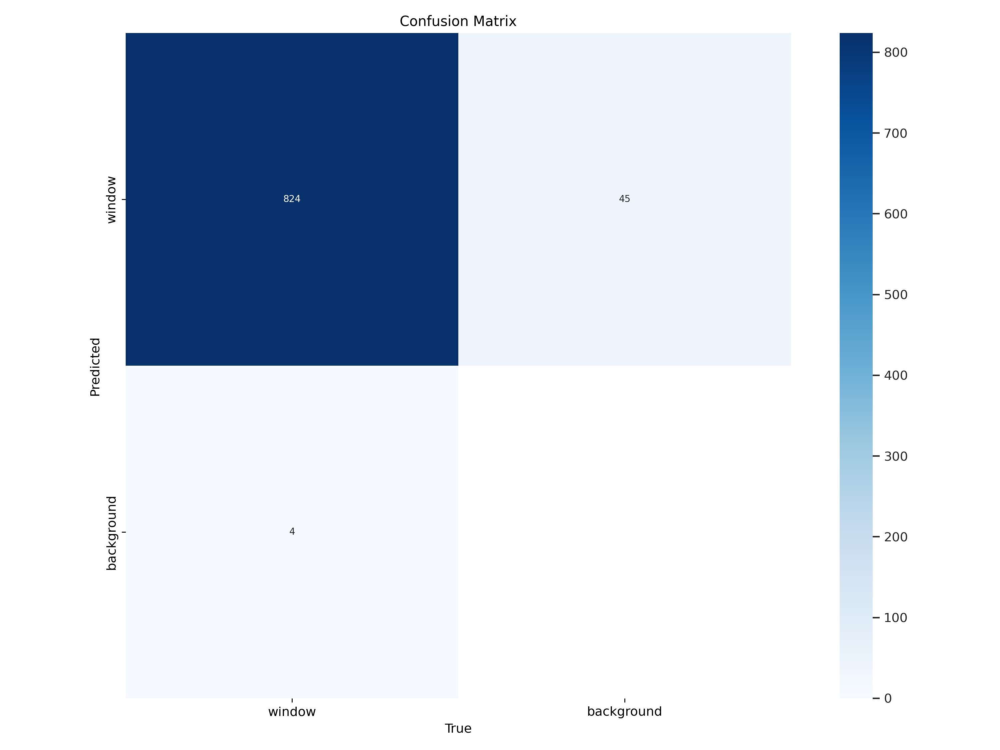

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train3/confusion_matrix.png', width=600)

## Performance plots

/content


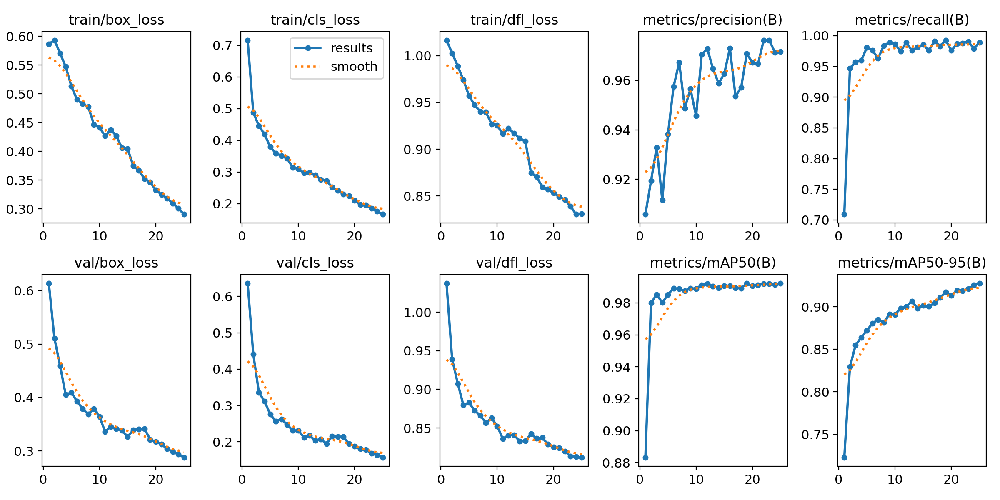

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train3/results.png', width=600)

/content


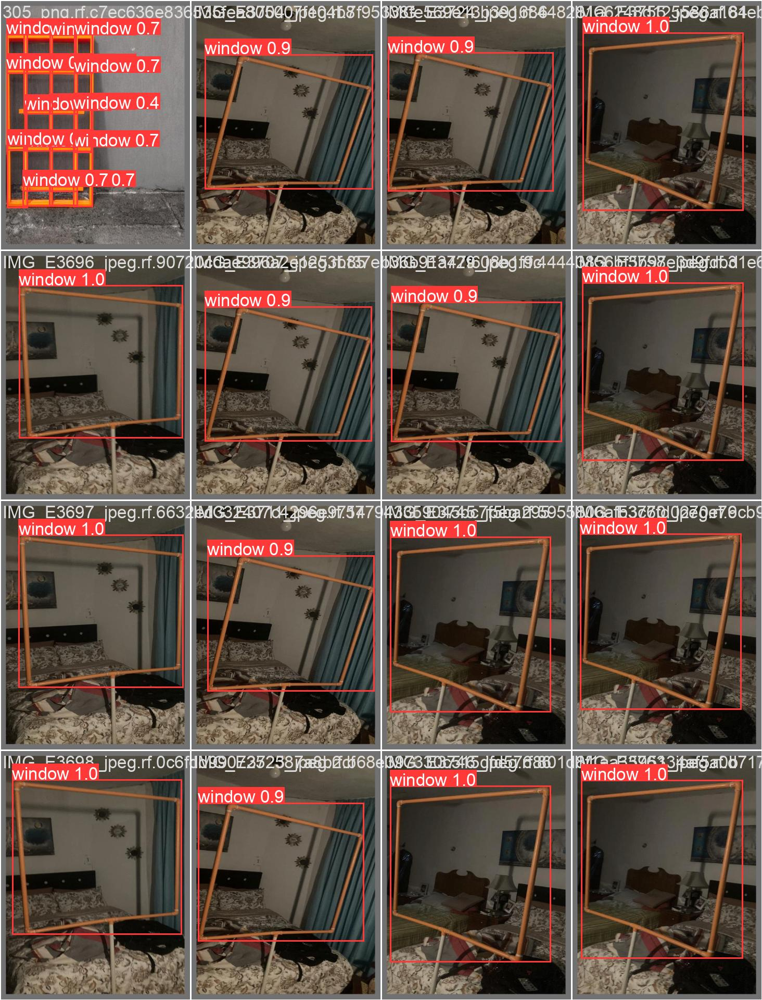

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train3/val_batch0_pred.jpg', width=600)

## Validate custom model

In [ ]:
%cd {HOME}

!yolo task=detect mode=val model={HOME}/runs/detect/train3/weights/best.pt data={dataset.location}/data.yaml

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11125971 parameters, 0 gradients, 28.4 GFLOPs
val: Scanning /content/window-labeling-7/valid/labels.cache... 631 images, 3 backgrounds, 0 corrupt: 100% 631/631 [00:00<?, ?it/s]
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 608, len(boxes) = 828. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 40/40 [00:09<00:00,  4.20it/s]
                   all        631        828      0.972      

## Inference with Custom Model

In [ ]:
  %cd {HOME}
!yolo task=detect mode=predict model={HOME}/runs/detect/train3/weights/best.pt conf=0.25 source=/content/window-labeling-7/test/images save=True

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11125971 parameters, 0 gradients, 28.4 GFLOPs

WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/315 /content/window-labeling-7/test/images/320_png.rf.d7d8fba5c87092fde62608b05c0a3b7b.jpg: 640x480 1 window, 195.8ms
image 2/315 /content/window-labeling-7/test/images/334_png.rf.b07b123aff1cf1ce05a93ce604c29741.jpg: 640x480 2 windows, 12.8ms
image 3/315 /content/window-labeling-7/test/images/346_png.rf.af2ec07638dc0f85b5bac5a3926ee6b4.jpg: 640x480 12 windows, 12.8ms
image 4/315 /content/window-labeling-7/test/images/362_png.rf.e608f1cf19b7a3406bbcbb45f293ab26.jpg: 640x480 13 windows, 13.6ms
image 5/315 /content/window-labeling-7/test/images/371_png.rf.a49247654ffc6c2be52473ba7bf31f4c.jpg: 640x480 5 windows, 12.0ms
image 6/315 /content/window-labeling-7/test/images/372_png.rf.93d76333356d90c581a67d9465cfa40c.jpg: 640x480 17 windows, 12.0ms
image 7/315 /content

### Print some results

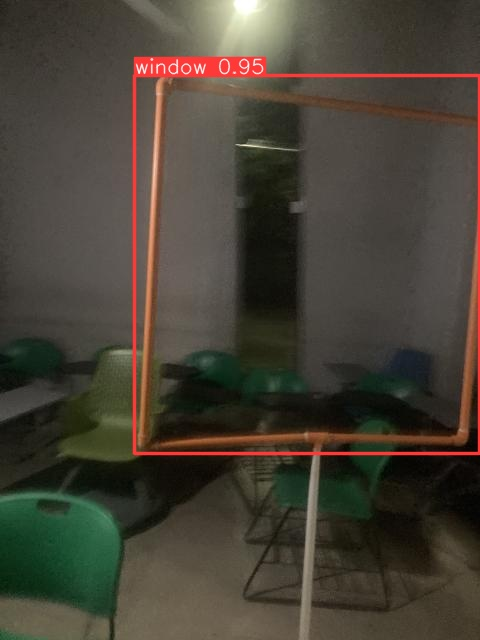

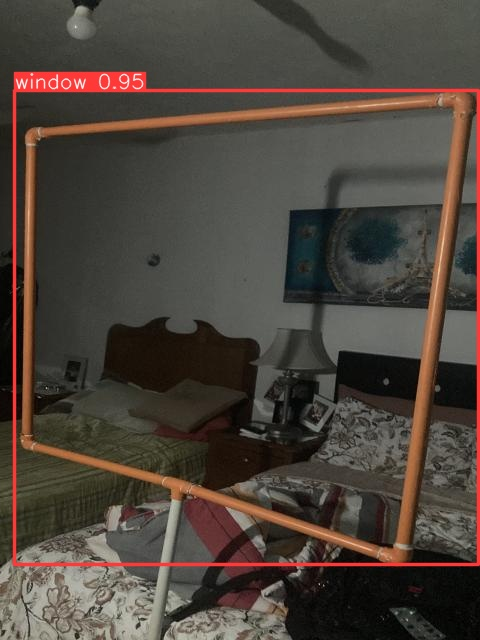

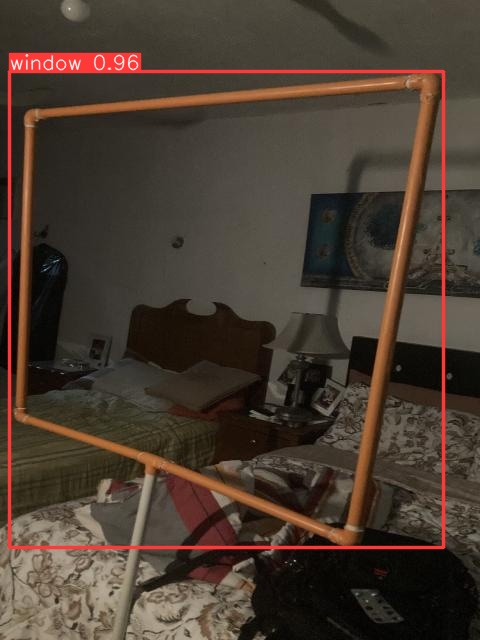

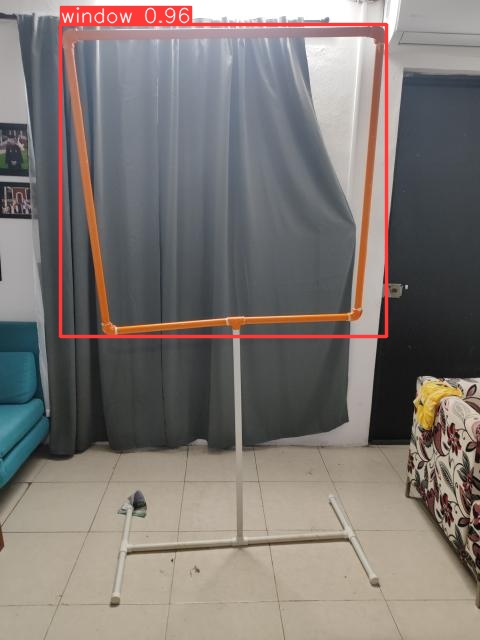

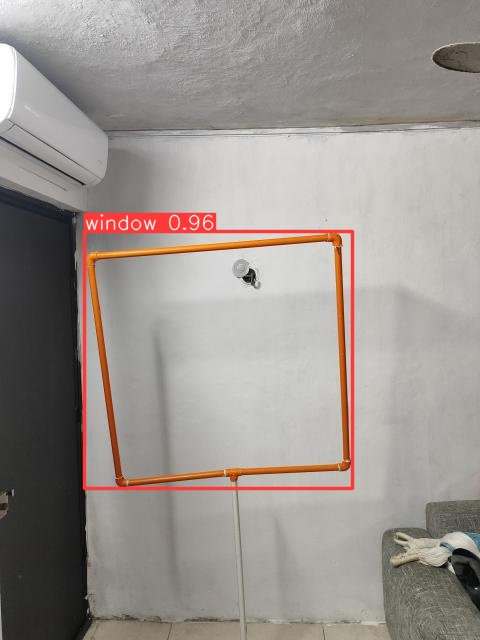

...

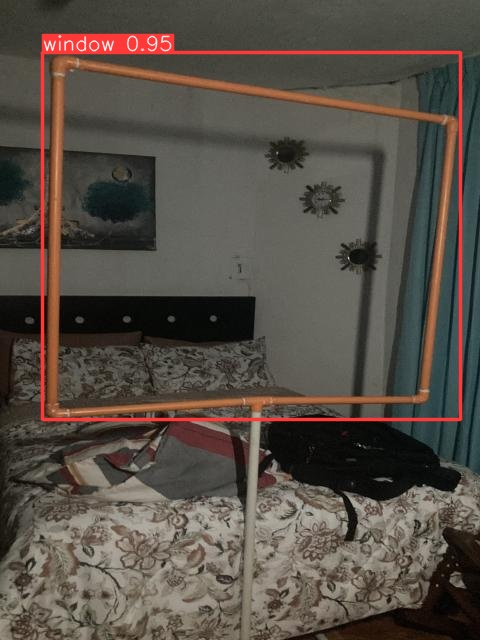

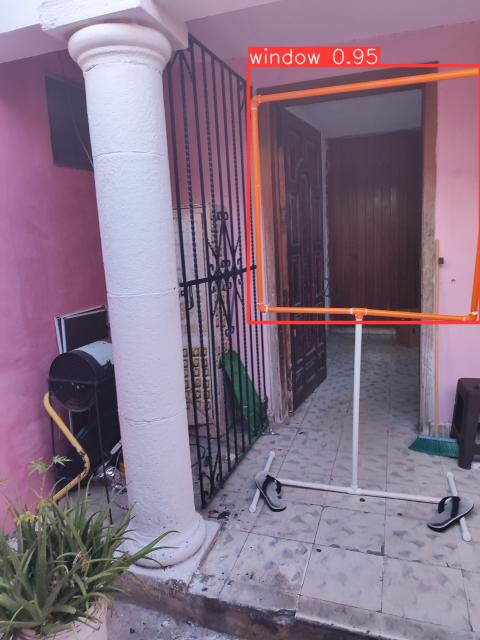

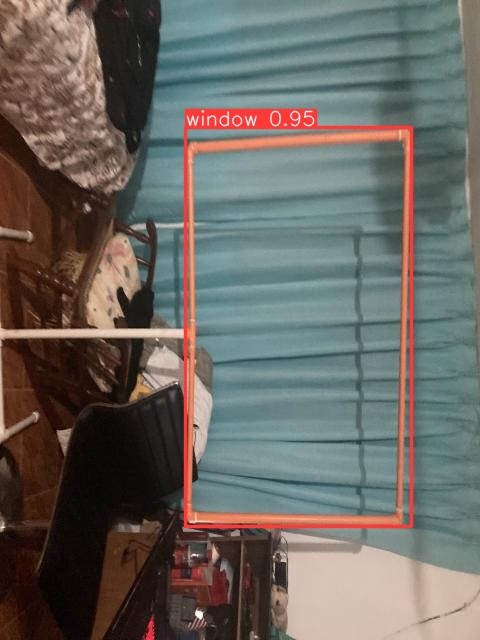

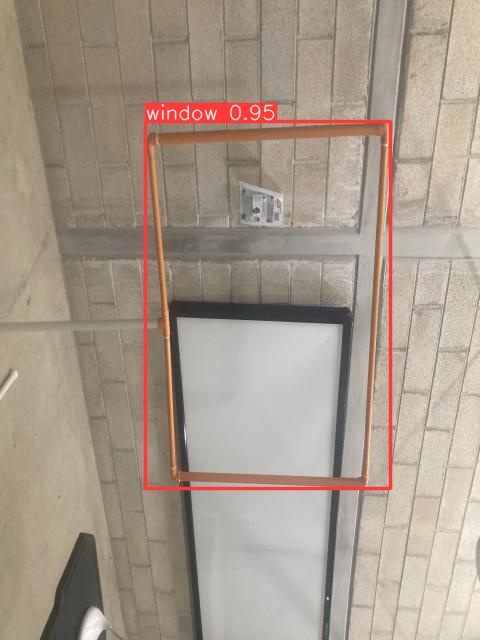

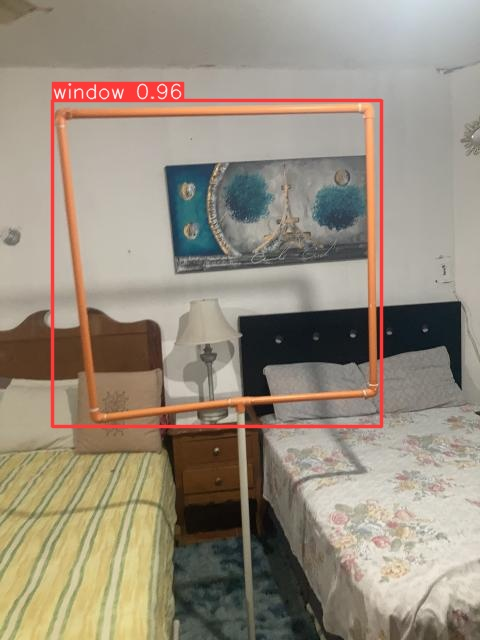

In [ ]:
import glob
from IPython.display import Image, display

for image_path in glob.glob(f'{HOME}/runs/detect/predict/*.jpg')[:200]:
      display(Image(filename=image_path, width=600))
      print("\n")